# Credit Card Fraud Detection
by **Sai Vamsy Dhulipala**

## Part I - EDA and Feature Engineering

## Importing necessary packages

In [1]:
import numpy as np
import pandas as pd
pd.set_option("display.max_columns", 400)

In [2]:
import matplotlib.pyplot as plt
import seaborn as sns
import sweetviz

plt.style.use("ggplot")
%matplotlib inline

In [3]:
from os import chdir, getcwd
import pickle

In [4]:
from sklearn.cluster import KMeans
from sklearn.neighbors import KNeighborsClassifier

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

## Importing the data

### Defining a function to read the data

In [5]:
def read_data(file_name, df_name):
    df = pd.read_csv(
        filepath_or_buffer= getcwd() + "/data/csv_data/" + file_name,
        index_col="trans_num"
    )
    df.name = df_name
    df.drop(columns="Unnamed: 0", inplace=True)
    return df

### Reading the data

In [6]:
folder_path = input("Please provide the path of the folder, by replacing \\ as /:")
chdir(folder_path)

In [7]:
train = read_data("fraudTrain.csv", "train")
test = read_data("fraudTest.csv", "test")

### Splitting the train set into train and valid sets

In [8]:
train, valid = train_test_split(
    train,
    test_size=0.3,
    random_state=42,
    stratify=train["is_fraud"]
)

train.name = "train"
valid.name = "valid"

## Inspecting the data

In [9]:
train.head()

,trans_date_trans_time,cc_num,merchant,category,amt,first,last,gender,street,city,state,zip,lat,long,city_pop,job,dob,unix_time,merch_lat,merch_long,is_fraud
trans_num,,,,,,,,,,,,,,,,,,,,,
9aaaca62069865fbf71b91dc69c75bfe,2019-04-08 23:46:57,3590736522064285,fraud_Stamm-Witting,shopping_net,199.87,Kimberly,Gonzalez,F,72966 Shannon Pass Apt. 391,Bauxite,AR,72011,34.5091,-92.4828,4074,"Scientist, audiological",1975-12-20,1333928817,34.963419,-92.300838,0
385daf000418e8ba543be01d6e0c3afd,2019-06-02 12:25:41,3546897637165774,"fraud_Lowe, Dietrich and Erdman",kids_pets,13.65,Kayla,Obrien,F,7921 Robert Port Suite 343,Prairie Hill,TX,76678,31.6591,-96.8094,263,Barrister,1956-05-30,1338639941,31.969251,-97.225975,0
382655367638cad7e4eaa69b08189cfa,2019-04-18 17:44:59,2260801330657968,fraud_Kub PLC,personal_care,47.98,Monique,Fox,F,755 Gardner Heights Apt. 420,Paxton,MA,1612,42.3066,-71.9202,4845,Accounting technician,1926-09-14,1334771099,42.419528,-71.966339,0
99c9a24d56636fa6d3c6b3b6ab5b4682,2020-02-01 23:01:47,30044330818990,fraud_Streich Ltd,home,157.10,Allison,Ayala,F,87665 Karen Mill Apt. 586,Fort Myers,FL,33967,26.4722,-81.8122,224256,Paramedic,1985-08-29,1359759707,27.091677,-81.537608,0
fb1cb28957e0faa76191cc31dbe2a21d,2019-09-17 23:20:40,4951647200979051,fraud_Waters-Cruickshank,health_fitness,111.12,Kimberly,Miller,F,75533 Tamara Valleys,Logan,IL,62856,37.9943,-88.9417,324,"Scientist, research (physical sciences)",1976-06-15,1347924040,37.713140,-89.380534,0


In [10]:
valid.head()

,trans_date_trans_time,cc_num,merchant,category,amt,first,last,gender,street,city,state,zip,lat,long,city_pop,job,dob,unix_time,merch_lat,merch_long,is_fraud
trans_num,,,,,,,,,,,,,,,,,,,,,
efbe01a3b08947a28fd922ecb1d09993,2019-12-13 22:17:17,30082025922891,fraud_Kulas Group,health_fitness,3.42,Kathleen,Thompson,F,199 Patterson Fords Apt. 132,Naples,FL,34112,26.1184,-81.7361,276002,"Pilot, airline",1934-06-23,1355437037,25.340639,-81.969550,0
22f228b0deb998db42fbdbdb585cd60b,2019-05-22 14:55:21,38588538868506,fraud_Prosacco LLC,personal_care,97.27,Jacqueline,Curry,F,3047 Jeff Place,Marathon,TX,79842,30.1886,-103.2214,498,Lexicographer,1990-11-23,1337698521,31.049011,-102.642045,0
c41d3873fd9999d624263a40a6df3790,2019-08-05 12:16:58,30030380240193,fraud_Leffler-Goldner,personal_care,84.73,William,Jenkins,M,50614 Kevin Point,Harper,TX,78631,30.2816,-99.2410,2395,"Pharmacist, community",1993-11-17,1344169018,30.911194,-99.769547,0
0bd75825d0dd2693a8611cbddf0ccc8c,2019-03-01 12:25:52,30199621383748,"fraud_Hauck, Dietrich and Funk",kids_pets,111.25,Theresa,Powell,F,117 Natasha Vista Suite 936,Leonard,TX,75452,33.4044,-96.2238,4090,Sub,1977-03-23,1330604752,33.700594,-96.249006,0
184d3750427f35cee975dee1f724d4a0,2019-10-14 23:52:38,30131826429364,fraud_Beier-Hyatt,shopping_pos,6.41,Brianna,Foley,F,57256 Raymond Ports,Knoxville,TN,37932,35.9335,-84.1481,391389,"Designer, industrial/product",1994-04-22,1350258758,35.516815,-84.590520,0


In [11]:
test.head()

,trans_date_trans_time,cc_num,merchant,category,amt,first,last,gender,street,city,state,zip,lat,long,city_pop,job,dob,unix_time,merch_lat,merch_long,is_fraud
trans_num,,,,,,,,,,,,,,,,,,,,,
2da90c7d74bd46a0caf3777415b3ebd3,2020-06-21 12:14:25,2291163933867244,fraud_Kirlin and Sons,personal_care,2.86,Jeff,Elliott,M,351 Darlene Green,Columbia,SC,29209,33.9659,-80.9355,333497,Mechanical engineer,1968-03-19,1371816865,33.986391,-81.200714,0
324cc204407e99f51b0d6ca0055005e7,2020-06-21 12:14:33,3573030041201292,fraud_Sporer-Keebler,personal_care,29.84,Joanne,Williams,F,3638 Marsh Union,Altonah,UT,84002,40.3207,-110.4360,302,"Sales professional, IT",1990-01-17,1371816873,39.450498,-109.960431,0
c81755dbbbea9d5c77f094348a7579be,2020-06-21 12:14:53,3598215285024754,"fraud_Swaniawski, Nitzsche and Welch",health_fitness,41.28,Ashley,Lopez,F,9333 Valentine Point,Bellmore,NY,11710,40.6729,-73.5365,34496,"Librarian, public",1970-10-21,1371816893,40.495810,-74.196111,0
2159175b9efe66dc301f149d3d5abf8c,2020-06-21 12:15:15,3591919803438423,fraud_Haley Group,misc_pos,60.05,Brian,Williams,M,32941 Krystal Mill Apt. 552,Titusville,FL,32780,28.5697,-80.8191,54767,Set designer,1987-07-25,1371816915,28.812398,-80.883061,0
57ff021bd3f328f8738bb535c302a31b,2020-06-21 12:15:17,3526826139003047,fraud_Johnston-Casper,travel,3.19,Nathan,Massey,M,5783 Evan Roads Apt. 465,Falmouth,MI,49632,44.2529,-85.0170,1126,Furniture designer,1955-07-06,1371816917,44.959148,-85.884734,0


In [12]:
print(f"Shape of train set: {train.shape}")
print(f"Shape of valid set: {valid.shape}")
print(f"Shape of test set: {test.shape}")

Shape of train set: (907672, 21)
Shape of valid set: (389003, 21)
Shape of test set: (555719, 21)


In [13]:
print(train.info(memory_usage="deep"), end="\n\n")
print(valid.info(memory_usage="deep"), end="\n\n")
print(test.info(memory_usage="deep"))

<class 'pandas.core.frame.DataFrame'>
Index: 907672 entries, 9aaaca62069865fbf71b91dc69c75bfe to a9d6576c8c5869e570e0ca7d1aac7c50
Data columns (total 21 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   trans_date_trans_time  907672 non-null  object 
 1   cc_num                 907672 non-null  int64  
 2   merchant               907672 non-null  object 
 3   category               907672 non-null  object 
 4   amt                    907672 non-null  float64
 5   first                  907672 non-null  object 
 6   last                   907672 non-null  object 
 7   gender                 907672 non-null  object 
 8   street                 907672 non-null  object 
 9   city                   907672 non-null  object 
 10  state                  907672 non-null  object 
 11  zip                    907672 non-null  int64  
 12  lat                    907672 non-null  float64
 13  long                   907672 non-nul

In [14]:
print(f"%age of frauds in train set: {round(train.is_fraud.value_counts(normalize=True).values[1], 5)*100}%")
print(f"%age of frauds in valid set: {round(valid.is_fraud.value_counts(normalize=True).values[1], 5)*100}%")
print(f"%age of frauds in test set: {round(test.is_fraud.value_counts(normalize=True).values[1], 5)*100}%")

%age of frauds in train set: 0.579%
%age of frauds in valid set: 0.579%
%age of frauds in test set: 0.386%


## Exploratory Data Analysis

### Using sweetviz to generate EDA report on train data

In [15]:
eda_report = sweetviz.analyze(train, "is_fraud")

Done! Use 'show' commands to display/save.   |██████████| [100%]   00:00 -> (00:00 left)



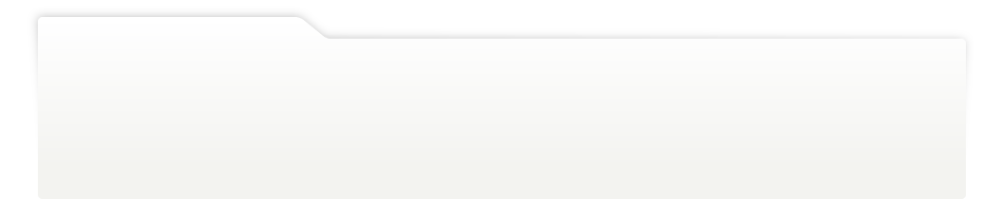
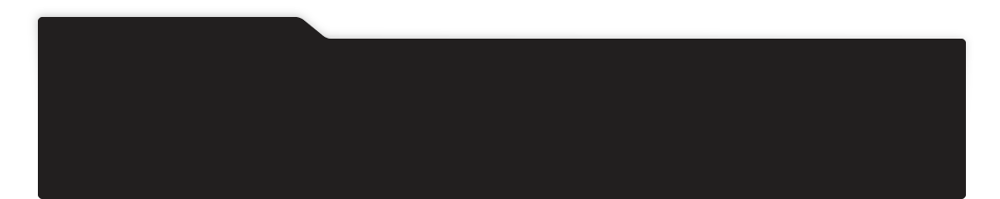
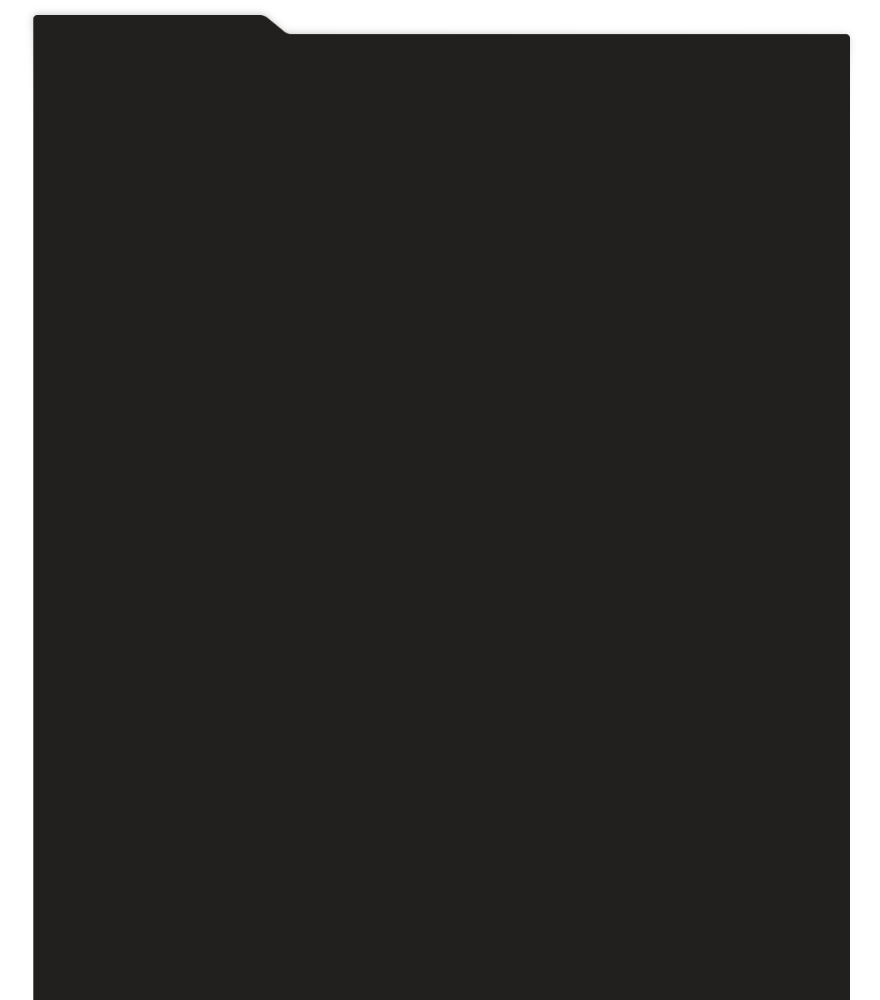
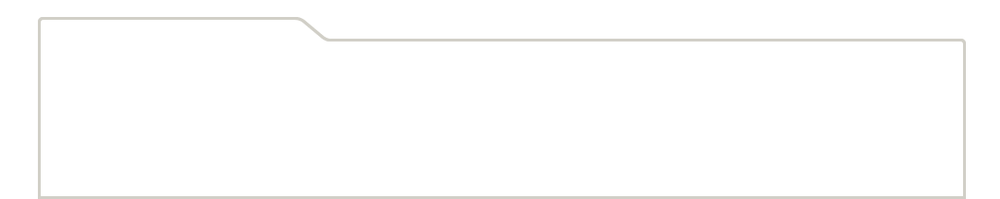
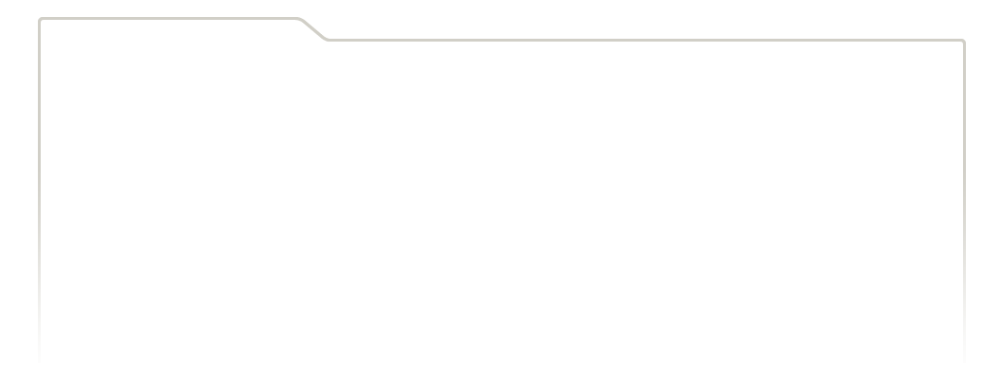
...
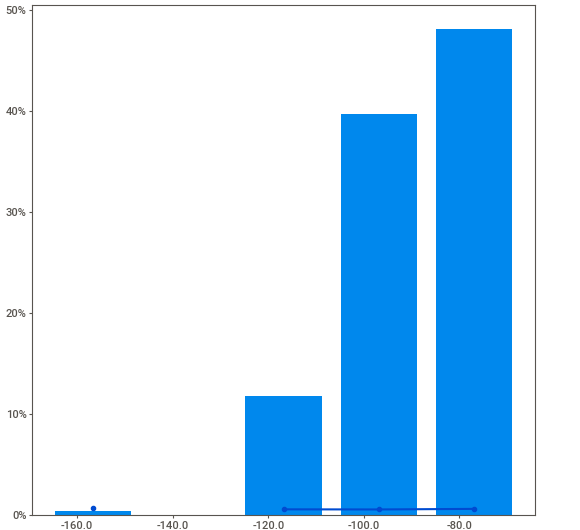
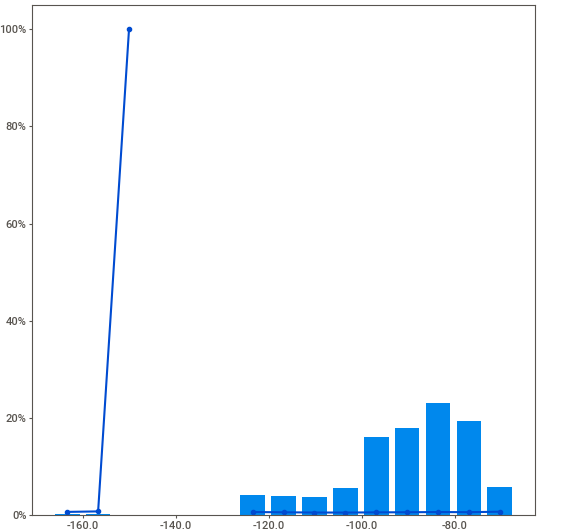
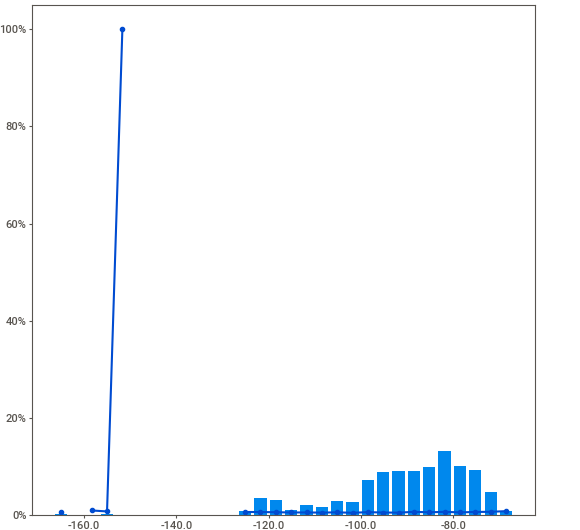
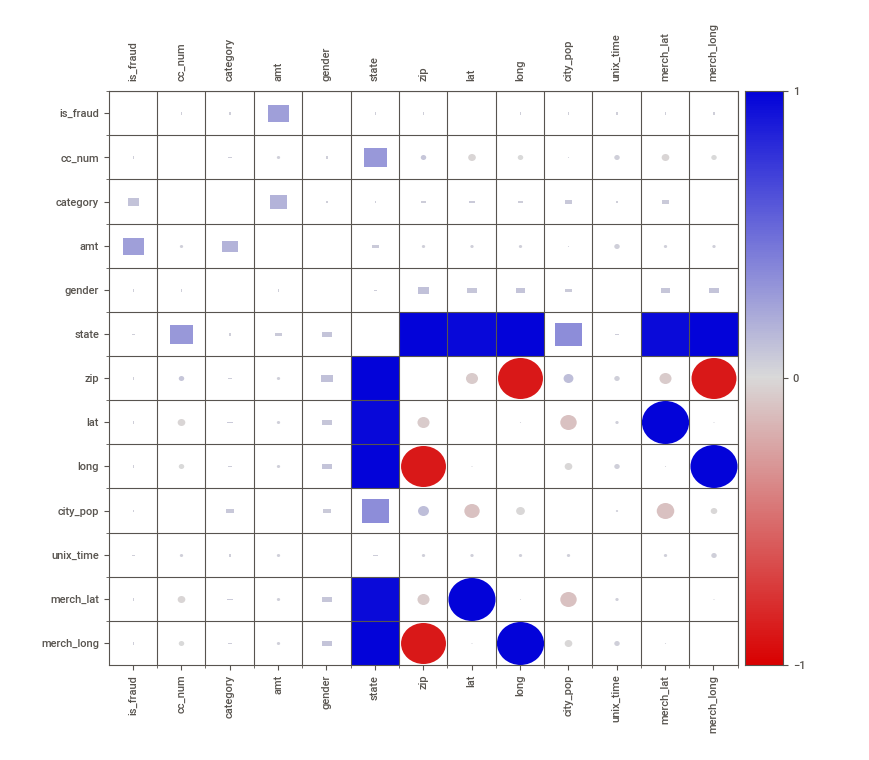
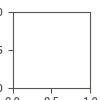

In [16]:
eda_report.show_notebook()

## Feature Engineering

To perform feature engineering, we divide the existing feature set into 4 components as below:
- **Transaction features**
- **Customer features**
- **Customer location features**
- **Merchant features**

### Defining a few multi-purpose functions to be used for feature engineering

#### 1. Defining a function for Log transformer

In [17]:
def log_transformer(df, col):
    
    df[col + "_log"] = df[col].apply(np.log)
    
    return df

#### 2. Defining a function to encode a feature using a specific groupby method

In [18]:
def encoder(df, train_df, col, groupby_col, method, suffix):
    
    # Creating an encoder dict from train set
    train_encoder_dict = train_df.groupby(col)[groupby_col].agg(method).to_dict()
    
    # Creating another encoder dict from df in order to replace any rare items which are not present in the train set
    df_encoder_dict = df.groupby(col)[groupby_col].agg(method).to_dict()
    
    # Updating the train_encoder_dict with df_encoder_dict
    train_encoder_dict = {**df_encoder_dict, **train_encoder_dict}

    df[col + suffix] = df[col].replace(train_encoder_dict)

    return df

#### 3. Defining a function to discretize a feature using k-means algorithm

In [19]:
def k_means_discretizer(df, train_df, col, k):
    
    train_vals = train_df[col].drop_duplicates().values.reshape(-1,1)
    discretizer = KMeans(n_clusters=k, max_iter=50, random_state=42)
    discretizer = discretizer.fit(train_vals)
    
    vals = df[col].values.reshape(-1,1)
    df[col + "_cat"] = discretizer.predict(vals)

    return df

#### 4. Defining a function to map division and region details for a state as additional geographic features 

In [20]:
def get_geo_features(df, state_col, prefix):
    
    # Importing the csv file from GitHub
    geo_features = pd.read_csv(
        "https://raw.githubusercontent.com/" + \
        "cphalpert/census-regions/master/" + \
        "us%20census%20bureau%20regions%20and%20divisions.csv",
        index_col="State Code")

    # mapping the features as new columns
    for feature in ["Division", "Region"]:
        feature_dict = geo_features[feature].to_dict()
        df[prefix + feature.lower()] = df[state_col].replace(feature_dict)
    
    return df

#### 5. Defining a funtion to extract 3 dimensional coordinates from the given latitude and longitude

In [21]:
def get_xyz_coordinates(df, prefix):
    
    df[prefix + "dim_x"] = np.cos(df[prefix + "lat"]) * np.cos(df[prefix + "long"])
    df[prefix + "dim_y"] = np.cos(df[prefix + "lat"]) * np.sin(df[prefix + "long"])
    df[prefix + "dim_z"] = np.sin(df[prefix + "lat"])

    return df

#### 6. Defining a function to encode city column with:
- frequency
- log of frequency
- log of city_pop
- median of amt
- mean of amt_log
- sum of target

In [22]:
def city_encoder(df, train_df, prefix):
    
    for groupby_col, method, suffix in [(prefix + "city", pd.Series.count, "_freq"), ("amt", pd.Series.median, "_spend"), 
    ("amt_log", pd.Series.mean, "_log_spend"), ("is_fraud", pd.Series.sum, "_sum")]:

        df = encoder(df, train_df, prefix + "city", groupby_col, method, suffix)

    for log_col_suffix in ["_freq", "_pop"]:
        df = log_transformer(df, prefix + "city" + log_col_suffix)

    return df

#### 7. Defining a function to encode state, division and region columns with:
- frequency for each geography
- log of frequency for each geography
- sum of city_pop for each geography
- log of sum of city_pop for each geography
- sum of city_spend for each geography
- sum of city_log_spend for each geography
- sum of target for each geography

In [23]:
def geography_encoder(df, train_df, prefix):
    
    for col in ["state", "division", "region"]:

        col = prefix + col
        unique_sum = lambda x: x.unique().sum()

        for groupby_col, method, suffix in [(col, pd.Series.count, "_freq"), (prefix + "city_pop", unique_sum, "_pop"), (prefix + "city_spend", 
        unique_sum, "_spend"), (prefix + "city_log_spend", unique_sum, "_log_spend"), ("is_fraud", pd.Series.sum, "_sum")]:

            df = encoder(df, train_df, col, groupby_col, method, suffix)

        for log_col_suffix in ["_freq", "_pop"]:
            df = log_transformer(df, col + log_col_suffix)

    return df

#### 8. Defining a function to compute ratios of:
- city to state
- city to division
- city to region
- state to division
- state to region
- division to region

for each of:
- freq
- freq_log
- pop
- pop_log
- spend
- log_spend
- sum

In [24]:
def get_geo_ratios(df, prefix):

    for suffix in ["_freq", "_freq_log", "_pop", "_pop_log", "_spend", "_log_spend", "_sum"]:
        
        for i, x in enumerate(["city", "state", "division"]):
            x = prefix + x

            for j, y in enumerate(["state", "division", "region"]):
                y = prefix + y

                if j < i:
                    pass
                else:
                    df[x + y + suffix + "_ratio"] = df[x + suffix]/df[y + suffix]

    return df

#### 9. Defining a function to get ratios of one feature to another

In [25]:
def get_feature_ratios(df, prefix):
    for col in ["city", "state", "division", "region"]:

        col = prefix + col

        for x, y in [("_freq", "_pop"), ("_freq_log", "_pop_log"), 
        ("_spend", "_pop"), ("_log_spend", "_pop_log"), 
        ("_spend", "_freq"), ("_log_spend", "_freq_log")]:

            df[col + x + y + "_ratio"] = df[col + x]/df[col + y]

    return df

### A. Transaction features

#### 1. Transforming amount using log transformation

In [26]:
def amt_log_transformer(df):
    df = log_transformer(df, "amt")
    return df

In [27]:
for df in train, valid, test:
    df = amt_log_transformer(df)

#### 2. Extracting multiple datetime related features from trans_date_trans_time column

In [28]:
def get_datetime_features(df):
    df["trans_date_trans_time"] = pd.to_datetime(df["trans_date_trans_time"])
    
    datetime_col = df["trans_date_trans_time"]
    
    df["trans_hour"] = datetime_col.dt.hour
    df["trans_year"] = datetime_col.dt.year
    df["trans_month"] = datetime_col.dt.month
    df["trans_day"] = datetime_col.dt.day
    df["trans_dayofweek"] = datetime_col.dt.dayofweek
    df["trans_weekofmonth"] = datetime_col.apply(lambda x: (x.day - 1) // 7 + 1)
    df["trans_daysinmonth"] = datetime_col.dt.daysinmonth
    df["trans_isweekend"] = df["trans_dayofweek"].apply(lambda x: 1 if x in [5,6] else 0)
    df["trans_ismonthend"] = datetime_col.dt.is_month_end.apply(lambda x: 1 if x is True else 0)
    
    return df

In [29]:
for df in train, valid, test:
    df = get_datetime_features(df)

#### 3. Encoding the following datetime features:
- trans_hour
- trans_year
- trans_month
- trans_day
- trans_dayofweek
- trans_weekofmonth
- trans_daysinmonth
- trans_isweekend
- trans_ismonthend

with:

- frequency
- log of frequency
- median of amt
- mean of amt_log
- sum of traget

In [30]:
def datetime_encoder(df):
    for col in ["trans_hour", "trans_year", "trans_month", "trans_day", "trans_dayofweek", 
    "trans_weekofmonth", "trans_daysinmonth", "trans_isweekend", "trans_ismonthend"]:
        
        for groupby_col, method, suffix in [(col, pd.Series.count, "_freq"), ("amt", pd.Series.median, "_spend"), 
        ("amt_log", pd.Series.mean, "_log_spend"), ("is_fraud", pd.Series.sum, "_sum")]:

            df = encoder(df, train, col, groupby_col, method, suffix)

        df = log_transformer(df, col + "_freq")

    return df

In [31]:
for df in train, valid, test:
    df = datetime_encoder(df)

#### 4. Encoding category feature with:
- frequency
- log of frequency
- median of amt
- mean of amt_log
- sum of traget

In [32]:
def category_encoder(df):
    for groupby_col, method, suffix in [("category", pd.Series.count, "_freq"), ("amt", pd.Series.median, "_spend"), 
    ("amt_log", pd.Series.mean, "_log_spend"), ("is_fraud", pd.Series.sum, "_sum")]:
    
        df = encoder(df, train, "category", groupby_col, method, suffix)
    
    df = log_transformer(df, "category_freq")
    
    return df

In [33]:
for df in train, valid, test:
    df = category_encoder(df)

### B. Customer features

#### 1. Converting gender to binary

In [34]:
def gender_to_bin(df):
    df["gender"] = df["gender"].apply(lambda x: \
        1 if x == "M" else 0)
    return df

In [35]:
for df in train, valid, test:
    df = gender_to_bin(df)

#### 2. Extracting age from DOB

In [36]:
def get_age(df):
    # Converting feature to datetime variable
    df["dob"] = pd.to_datetime(df["dob"])
    
    #Computing age
    def compute_age(dob):
        from datetime import date
        today = date.today()
        return today.year - dob.year - ((today.month, today.day) < (dob.month, dob.day))
    
    df["age"] = df["dob"].apply(compute_age)
    
    return df

In [37]:
for df in train, valid, test:
    df = get_age(df)

#### 3. Discretizing age into 4 categories as below:
- under 18
- 18 to 44
- 45 to 64
- 65 and above

In [38]:
def discretize_age(df):
    age_numeric = df["age"]
    
    df["age_cat"] = pd.cut(
        x=age_numeric,
        bins=[0, 17, 44, 64, np.inf],
        labels=["under 18", "18-44", "45-64", "65 and above"]
    )
    
    return df

In [39]:
for df in train, valid, test:
    df = discretize_age(df)

#### 4. Encoding job and age_cat using:
- frequency
- log of frequency
- median of amt
- mean of amt_log
- sum of traget

In [40]:
def cust_encoder(df):
    for col in ["job", "age_cat"]:
        
        for groupby_col, method, suffix in [(col, pd.Series.count, "_freq"), ("amt", pd.Series.median, "_spend"), 
        ("amt_log", pd.Series.mean, "_log_spend"), ("is_fraud", pd.Series.sum, "_sum")]:

            df = encoder(df, train, col, groupby_col, method, suffix)

        df = log_transformer(df, col + "_freq")

    return df

In [41]:
for df in train, valid, test:
    df = cust_encoder(df)

### C. Customer location features

#### 1. Adding "cust_" prefix to multiple features

In [42]:
def add_prefix(df):
    cols = ["city", "state", "city_pop", "lat", "long"]
    col_dict = {col: "cust_" + col for col in cols}
    df.rename(columns=col_dict, inplace=True)
    return df

In [43]:
for df in train, valid, test:
    df = add_prefix(df)

#### 2. Adding division and region columns as additional geographic features

In [44]:
def get_cust_geo_features(df):
    df = get_geo_features(df, "cust_state", "cust_")
    return df

In [45]:
for df in train, valid, test:
    df = get_cust_geo_features(df)

#### 3. Extracting 3 dimensional coordinates from cust_lat and cust_long

In [46]:
def get_cust_xyz_coordinates(df):
    df = get_xyz_coordinates(df, "cust_")
    return df

In [47]:
for df in train, valid, test:
    df = get_cust_xyz_coordinates(df)

#### 4. Encoding cust_city column with:
- frequency
- log of frequency
- log of city_pop
- median of amt
- mean of amt_log
- sum of target

In [48]:
def cust_city_encoder(df):
    df = city_encoder(df, train, "cust_")
    return df

In [49]:
for df in train, valid, test:
    df = cust_city_encoder(df)

#### 5. Encoding cust_state, cust_division and cust_region with:
- frequency for each geography
- log of frequency for each geography
- sum of city_pop for each geography
- log of sum of city_pop for each geography
- sum of city_spend for each geography
- sum of city_log_spend for each geography
- sum of target for each geography

In [50]:
def cust_geography_encoder(df):
    df = geography_encoder(df, train, "cust_")
    return df

In [51]:
for df in train, valid, test:
    df = cust_geography_encoder(df)

#### 6. Computing ratios of:
- cust_city to cust_state
- cust_city to cust_division
- cust_city to cust_region
- cust_state to cust_division
- cust_state to cust_region
- cust_division to cust_region

for each of:

- freq
- freq_log
- pop
- pop_log
- spend
- log_spend
- sum

In [52]:
def get_cust_geo_ratios(df):
    df = get_geo_ratios(df, "cust_")
    return df

In [53]:
for df in train, valid, test:
    df = get_cust_geo_ratios(df)

#### 7. Computing ratios of one feature to another

In [54]:
def get_cust_feature_ratios(df):
    df = get_feature_ratios(df, "cust_")
    return df

In [55]:
for df in train, valid, test:
    df = get_cust_feature_ratios(df)

### D. Merchant features

#### 1. Encoding merchant column with:
- frequency
- log of frequency
- log of city_pop
- median of amt
- mean of amt_log
- sum of target

In [56]:
def merchant_encoder(df):
    for groupby_col, method, suffix in [("merchant", pd.Series.count, "_freq"), ("amt", pd.Series.median, "_spend"), 
    ("amt_log", pd.Series.mean, "_log_spend"), ("is_fraud", pd.Series.sum, "_sum")]:
    
        df = encoder(df, train, "merchant", groupby_col, method, suffix)
    
    df = log_transformer(df, "merchant_freq")
    
    return df

In [57]:
for df in train, valid, test:
    df = merchant_encoder(df)

#### 2. Extracting 3 dimensional coordinates from merch_lat and merch_long

In [58]:
def get_merch_xyz_coordinates(df):
    df = get_xyz_coordinates(df, "merch_")
    return df

In [59]:
for df in train, valid, test:
    df = get_merch_xyz_coordinates(df)

#### 3. Computing distance in km between cust_lat and cust_long and merch_lat and merch_long based on haversine formula

In [60]:
def get_distance(df):

    lat_p, lon_p = df['cust_lat'].values, df['cust_long'].values
    lat_d, lon_d = df['merch_lat'].values, df['merch_long'].values
    radius = 6371 # km

    dlat = np.radians(lat_d - lat_p)
    dlon = np.radians(lon_d - lon_p)
    a = np.sin(dlat/2) * np.sin(dlat/2) + np.cos(np.radians(lat_p)) * np.cos(np.radians(lat_d)) * np.sin(dlon/2) * np.sin(dlon/2)
    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1-a))
    df["distance"] = radius * c

    return df

In [61]:
for df in train, valid, test:
    df = get_distance(df)

#### 4. Discretizing distance using k-means into 3 categories

In [62]:
def distance_discretizer(df):
    df = k_means_discretizer(df, train, "distance", 3)
    return df

In [63]:
for df in train, valid, test:
    df = distance_discretizer(df)

#### 5. Encoding distance_cat with:
- frequency
- log of frequency
- median of amt
- mean of amt_log
- sum of traget

In [64]:
def distance_cat_encoder(df):
    for groupby_col, method, suffix in [("distance_cat", pd.Series.count, "_freq"), ("amt", pd.Series.median, "_spend"), 
    ("amt_log", pd.Series.mean, "_log_spend"), ("is_fraud", pd.Series.sum, "_sum")]:
    
        df = encoder(df, train, "distance_cat", groupby_col, method, suffix)
    
    df = log_transformer(df, "distance_cat_freq")
    
    return df

In [65]:
for df in train, valid, test:
    df = distance_cat_encoder(df)

#### 6. Getting the nearset city based on latitudes and longitude from customer city using K Nearest Neighbours Algorithm

In [66]:
cust_city_lat_long = train[["cust_city", "cust_lat", "cust_long"]].drop_duplicates()
cust_city_lat_long = cust_city_lat_long.set_index("cust_city")

knn = KNeighborsClassifier(n_neighbors=1, weights="distance", n_jobs=-1)
knn = knn.fit(cust_city_lat_long.values, cust_city_lat_long.index)

In [67]:
def get_nearest_city(df):
    df["merch_city"] = knn.predict(df[["merch_lat", "merch_long"]].values)
    return df

In [68]:
for df in train, valid, test:
    df = get_nearest_city(df)

#### 7. Encoding merch_city with cust_city_pop, cust_state as merch_city_pop, merch_state respectively

In [69]:
def merch_city_state_encoder(df):
    for col in ["city_pop", "state"]:
        
        encoder_dict = train.groupby("cust_city")["cust_"+ col].agg(lambda x: x.unique()[0]).to_dict()

        df["merch_" + col] = df["merch_city"].replace(encoder_dict)

    return df

In [70]:
for df in train, valid, test:
    df = merch_city_state_encoder(df)

#### 8. Adding division and region columns as additional geographic features

In [71]:
def get_merch_geo_features(df):
    df = get_geo_features(df, "merch_state", "merch_")
    return df

In [72]:
for df in train, valid, test:
    df = get_merch_geo_features(df)

#### 9. Encoding merch_city column with:
- frequency
- log of frequency
- log of city_pop
- median of amt
- mean of amt_log
- sum of target

In [73]:
def merch_city_encoder(df):
    df = city_encoder(df, train, "merch_")
    return df

In [74]:
for df in train, valid, test:
    df = merch_city_encoder(df)

#### 10. Encoding merch_state, merch_division and merch_region with:
- frequency for each geography
- log of frequency for each geography
- sum of city_pop for each geography
- log of sum of city_pop for each geography
- sum of city_spend for each geography
- sum of city_log_spend for each geography
- sum of target for each geography

In [75]:
def merch_geography_encoder(df):
    df = geography_encoder(df, train, "merch_")
    return df

In [76]:
for df in train, valid, test:
    df = merch_geography_encoder(df)

#### 11. Computing ratios of:
- merch_city to merch_state
- merch_city to merch_division
- merch_city to merch_region
- merch_state to merch_division
- merch_state to merch_region
- merch_division to merch_region

for each of:

- freq
- freq_log
- pop
- pop_log
- spend
- log_spend
- sum

In [77]:
def get_merch_geo_ratios(df):
    df = get_geo_ratios(df, "merch_")
    return df

In [78]:
for df in train, valid, test:
    df = get_merch_geo_ratios(df)

#### 12. Computing ratios of one feature to another

In [79]:
def get_merch_feature_ratios(df):
    df = get_feature_ratios(df, "merch_")
    return df

In [80]:
for df in train, valid, test:
    df = get_merch_feature_ratios(df)

In [81]:
print(f"Shape of train set: {train.shape}")
print(f"Shape of valid set: {valid.shape}")
print(f"Shape of test set: {test.shape}")

Shape of train set: (907672, 304)
Shape of valid set: (389003, 304)
Shape of test set: (555719, 304)


### Other transformations

#### 1. Dropping unnecessary columns

In [82]:
cols_to_drop = ["trans_date_trans_time", "cc_num", "merchant", "category", "first", "last", "street", "cust_city", "cust_state", "zip", "cust_lat", "cust_long", "job", "dob", "unix_time", "merch_lat", "merch_long", "trans_hour", "trans_year", "trans_month", "trans_day", "trans_dayofweek", "trans_weekofmonth", "trans_daysinmonth", "age_cat", "cust_division", "cust_region", "distance_cat", "merch_city", "merch_state", "merch_division", "merch_region"]

In [84]:
for df in train, valid, test:
    df.drop(cols_to_drop, axis=1, inplace=True)

#### 2. Scaling the data using standard scaler

In [86]:
bool_cols = ["gender", "is_fraud", "trans_isweekend", "trans_ismonthend"]
cols_to_scale = train.columns[~train.columns.isin(bool_cols)]

In [87]:
scaler = StandardScaler()
scaler = scaler.fit(train[cols_to_scale])

In [88]:
train[cols_to_scale] = scaler.transform(train[cols_to_scale])
valid[cols_to_scale] = scaler.transform(valid[cols_to_scale])
test[cols_to_scale] = scaler.transform(test[cols_to_scale])

### Generating the EDA report post feature engineering

In [89]:
eda_report_2 = sweetviz.analyze(train, "is_fraud", pairwise_analysis="off")

Feature: merch_region_log_spend_freq_log_ratio|██████████| [100%]   03:49 -> (00:00 left)



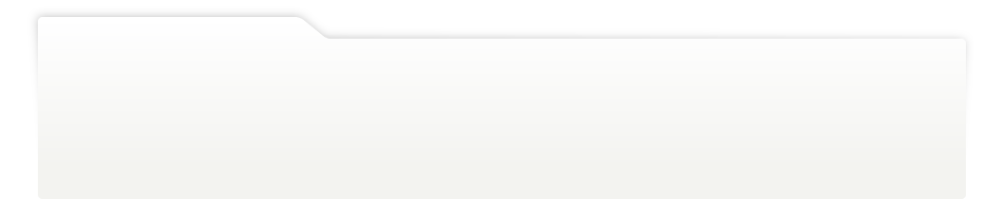
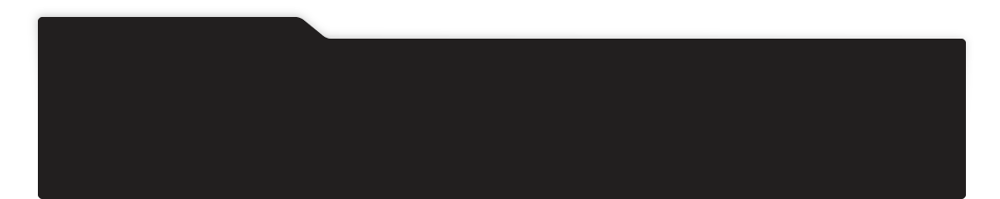
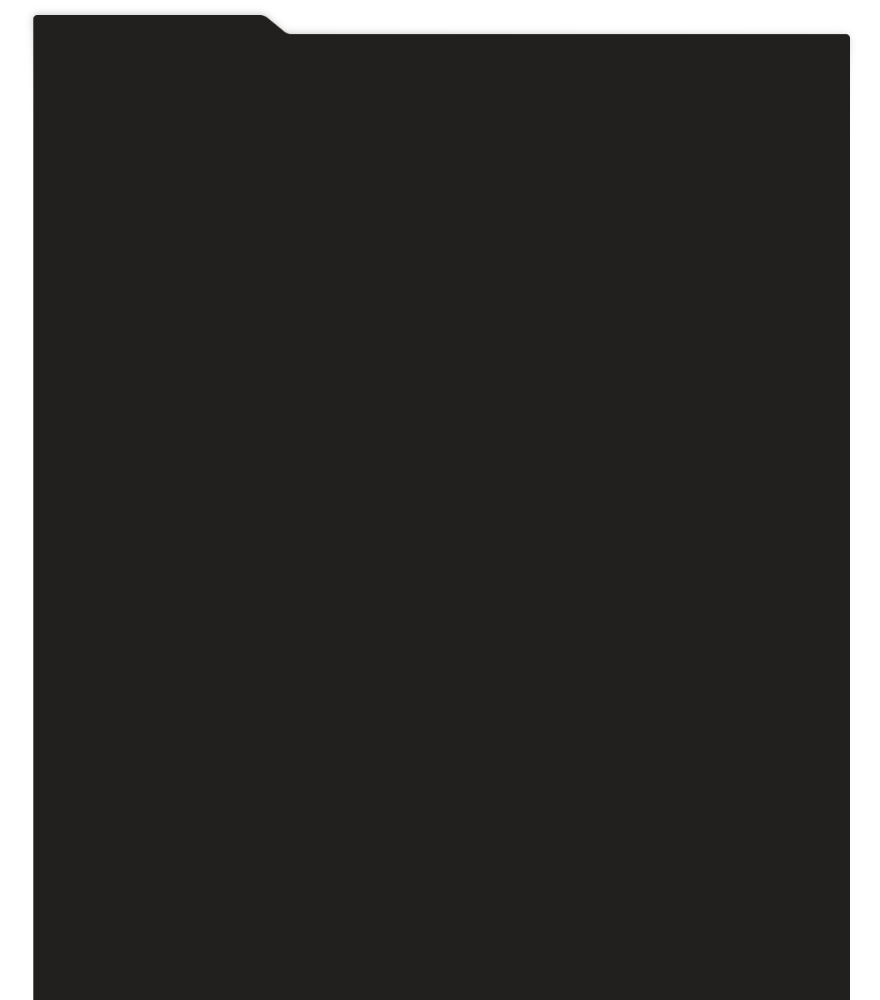
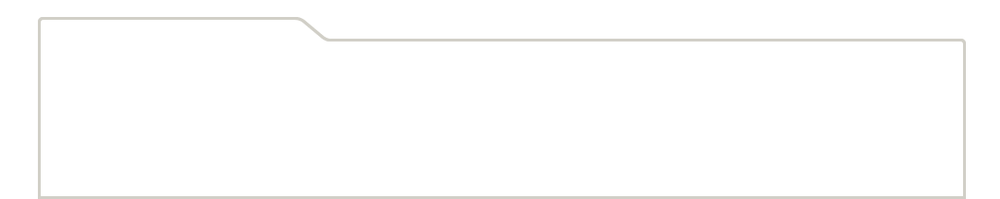
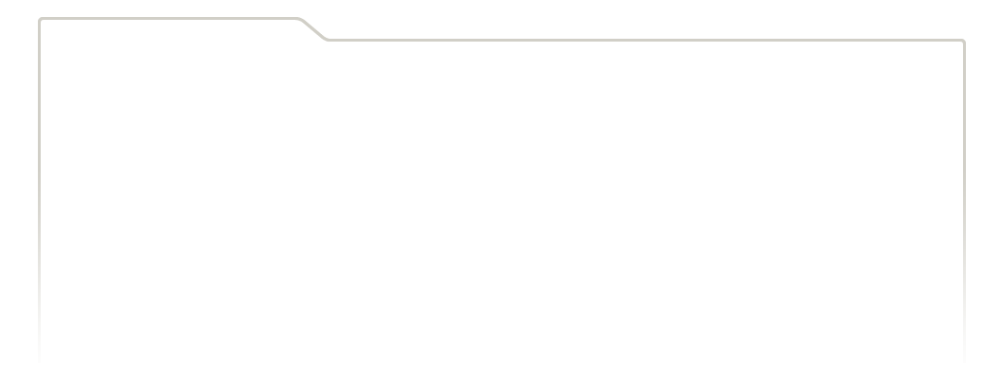
...
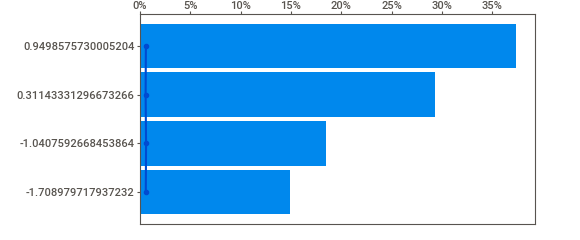
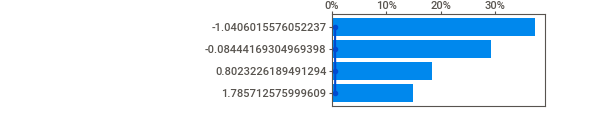
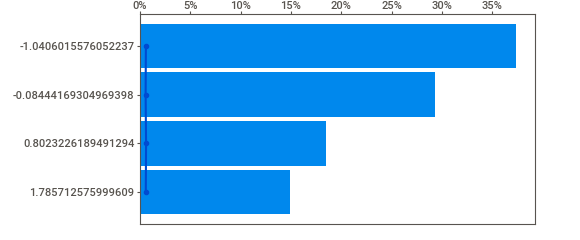
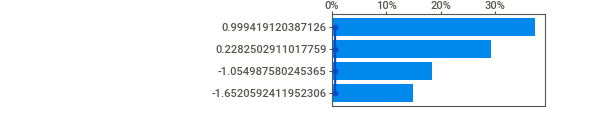
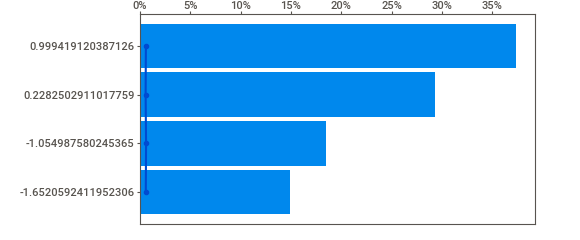

Report 'D:\MS Data Science\Upgrad Course Files\Capstone Project IIIT-B\final/data/eda_reports/eda_report_2.html' was saved to storage.


In [90]:
eda_report_2.show_notebook(filepath=getcwd() + "/data/eda_reports/" + "eda_report_2.html")

## Saving the data into pickle files

In [91]:
for df in train, valid, test:
    pickle.dump(df, open(getcwd() + "/data/cleaned_data/" + df.name + ".pkl", "wb"))
    del df

### Deleting all the variables present in the memory

In [92]:
%reset -f